<a href="https://colab.research.google.com/github/chayhuixiang/sf-pokemon-data-analytics/blob/main/%5BInstructors%5D_MLDA_Visualisation_Workshop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data Analytics (HX)

We will be using a open source dataset of Pokemon Go Spawns at the San Francisco Bay Area, from [Kaggle](https://www.kaggle.com/datasets/kveykva/sf-bay-area-pokemon-go-spawns).

Using this dataset, we will attempt to analyse for various data insights and obtain a comprehensive description of the data by investigating the distribution of pokemon by various factors (Name, Type, Time etc.)

## Extracting the dataset from Google Drive

Run these cells to download the dataset!

In [ ]:
# Download the csv file from google drive into the sample_data folder
! wget "https://drive.google.com/u/0/uc?id=1NGvsf9pwkXW_3G6xM7ar-OhnviYNjFKJ&export=download" -O "pokemon-spawns.csv" 
! mv pokemon-spawns.csv /content/sample_data/

--2022-03-31 04:03:19--  https://drive.google.com/u/0/uc?id=1NGvsf9pwkXW_3G6xM7ar-OhnviYNjFKJ&export=download
Resolving drive.google.com (drive.google.com)... 172.253.122.138, 172.253.122.100, 172.253.122.101, ...
Connecting to drive.google.com (drive.google.com)|172.253.122.138|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://drive.google.com/uc?id=1NGvsf9pwkXW_3G6xM7ar-OhnviYNjFKJ&export=download [following]
--2022-03-31 04:03:19--  https://drive.google.com/uc?id=1NGvsf9pwkXW_3G6xM7ar-OhnviYNjFKJ&export=download
Reusing existing connection to drive.google.com:443.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-0o-9k-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/duv13m8ekq1pil0rejlter99fplmepus/1648699350000/16001511582918015797/*/1NGvsf9pwkXW_3G6xM7ar-OhnviYNjFKJ?e=download [following]
--2022-03-31 04:03:19--  https://doc-0o-9k-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksu

## Data Pre-Processing
1. Read the csv file we have using the Pandas library

2. Display the dataframe obtained

3. Optimise memory usage

4. Filter unnecessary information, noisy data and perform miscellaneous data appending or slicing

In [ ]:
# Converting the csv file into a pandas dataframe
import pandas as pd
import numpy as np

raw_df = pd.read_csv('sample_data/pokemon-spawns.csv')

In [ ]:
# Sampling random indexes of the dataframe to see the kind of data we are dealing with
print(raw_df.shape)
raw_df.sample(5)

(314105, 8)


,s2_id,s2_token,num,name,lat,lng,encounter_ms,disppear_ms
251267,-8520154042519781000,89c2550a131,133,Eevee,40.797693,-74.171933,1469556722660,1469556600059
91902,-9182921997280084000,808fb518a4f,19,Rattata,37.297101,-122.031669,1469543807644,1469543565737
243994,-8520149661653139000,89c2590644d,16,Pidgey,40.746477,-73.979100,1469557007380,1469556590362
149007,-9185803797929132000,8085781d137,19,Rattata,37.946631,-122.342946,1469549216380,1469548613682
23383,-9182963405059785000,808f8f6f84f,35,Clefairy,37.747685,-122.162675,-1,1469527523804


In [ ]:
# Retrieving all Pidgey spawns
raw_df[raw_df["name"] == "Pidgey"]

,s2_id,s2_token,num,name,lat,lng,encounter_ms,disppear_ms
1,-9185794529389707000,8085808b51d,16,Pidgey,37.794746,-122.406420,1469520297172,1469519919992
3,-9185794082713108000,808580f3587,16,Pidgey,37.795644,-122.407128,-1,1469519920134
19,-9182921720254693000,808fb559245,16,Pidgey,37.301723,-121.996139,1469520753268,1469520277303
31,-9183344529720214000,808e34ce653,16,Pidgey,37.301422,-121.933667,1469521132460,1469520277359
35,-9182921696632373000,808fb55ec3b,16,Pidgey,37.303392,-121.996584,1469520439948,1469520277375
...,...,...,...,...,...,...,...,...
313963,-9182982461829677000,808f7e1af2d,16,Pidgey,37.759578,-122.433143,1469670017300,1469669277684
313976,-9182982461829677000,808f7e1af2d,16,Pidgey,37.759578,-122.433143,1469670017300,1469669278924
314018,-9185786976689717000,80858769ea9,16,Pidgey,37.769470,-122.470651,1469669842372,1469669287485
314029,-9185786976689717000,80858769ea9,16,Pidgey,37.769470,-122.470651,1469669842372,1469669288562


In [ ]:
# Checking for weird data with invalid encounter_ms
raw_df[raw_df["encounter_ms"] <= 0]

,s2_id,s2_token,num,name,lat,lng,encounter_ms,disppear_ms
3,-9185794082713108000,808580f3587,16,Pidgey,37.795644,-122.407128,-1,1469519920134
18,-9182921720254693000,808fb5595a1,19,Rattata,37.301284,-121.998094,-1,1469520277295
27,-9182898100082049000,808fcad4cdb,133,Eevee,37.301852,-121.950999,-1,1469520277338
32,-9182921707369791000,808fb55c38f,19,Rattata,37.303030,-121.999782,-1,1469520277364
44,-9182898226783584000,808fcab7557,46,Paras,37.303843,-121.975615,-1,1469520277481
...,...,...,...,...,...,...,...,...
313970,-9182982470419612000,808f7e18e05,14,Kakuna,37.763771,-122.426773,-1,1469669277922
313983,-9182982470419612000,808f7e18e05,14,Kakuna,37.763771,-122.426773,-1,1469669279224
314034,-9182983050240197000,808f7d91e61,41,Zubat,37.744556,-122.476135,-1,1469670143874
314040,-9182983037355295000,808f7d94b29,29,Nidoran (f),37.741760,-122.469501,-1,1469670230083


In [ ]:
# Column rename and checking for weird data with invalid disappear_ms
raw_df.rename(columns={"disppear_ms":"disappear_ms"}, inplace=True)
raw_df[raw_df["disappear_ms"] <= 0]

,s2_id,s2_token,num,name,lat,lng,encounter_ms,disappear_ms


In [ ]:
# Retrieving all Nidoran ♀ spawns
raw_df[(raw_df['num'] == 29)]

,s2_id,s2_token,num,name,lat,lng,encounter_ms,disappear_ms
113,-9183344703666389000,808e34a5f65,29,Nidoran♀,37.304719,-121.908419,1469520513908,1469520277733
392,-9182898175243977000,808fcac328f,29,Nidoran♀,37.315827,-121.959265,1469521115516,1469520279146
429,-9182897773664535000,808fcb20a8f,29,Nidoran♀,37.317760,-121.947089,1469521104508,1469520279343
582,-9182896085742387000,808fcca9d45,29,Nidoran♀,37.323540,-121.901573,1469520702836,1469520280039
881,-9182897378527543000,808fcb7cf81,29,Nidoran♀,37.346622,-121.905308,1469520954084,1469520282635
...,...,...,...,...,...,...,...,...
314083,-9185786940182495000,80858772545,29,Nidoran (f),37.768922,-122.483298,1469670572436,1469670421252
314088,-9185786940182495000,80858772545,29,Nidoran (f),37.768922,-122.483298,1469670572436,1469670432203
314093,-9185786940182495000,80858772545,29,Nidoran (f),37.768922,-122.483298,1469670572436,1469670434000
314099,-9185786940182495000,80858772545,29,Nidoran (f),37.768922,-122.483298,1469670572436,1469670452451


In [ ]:
# Retrieving all Nidoran ♂ spawns
raw_df[(raw_df['num'] == 32)]

,s2_id,s2_token,num,name,lat,lng,encounter_ms,disappear_ms
228,-9183346125300564000,808e335ab5d,32,Nidoran♂,37.309051,-121.890725,1469520398612,1469520278286
569,-9182898022772638000,808fcae6927,32,Nidoran♂,37.323472,-121.955088,1469520928252,1469520279961
602,-9182898022772638000,808fcae6927,32,Nidoran♂,37.323472,-121.955088,1469520928252,1469520280159
1210,-9182920960045482000,808fb60a4b1,32,Nidoran♂,37.362668,-122.011508,1469521139108,1469520284305
1238,-9182921013732573000,808fb5fd861,32,Nidoran♂,37.363382,-122.000670,1469520713124,1469520284484
...,...,...,...,...,...,...,...,...
313821,-9185787038966743000,8085875b6c9,32,Nidoran (m),37.766869,-122.462425,1469668895108,1469668486629
313825,-9185787038966743000,8085875b6c9,32,Nidoran (m),37.766869,-122.462425,1469668895108,1469668486692
313923,-9185794477850100000,8085809737b,32,Nidoran (m),37.783066,-122.418986,1469669398668,1469668929559
314043,-9182982698052878000,808f7de3e63,32,Nidoran (m),37.748589,-122.451191,1469670402156,1469670236886


Interesting Points to note:

1. There exists datapoints with encounter_ms = -1, but there exists no datapoints with disappear_ms = -1.

2. The timestamps of encounter_ms are later than timestamps of disappear_ms.

3. 2 different name labels for Nidoran (eg. Nidoran♂ and Nidoran (m))

4. There is a lack of information regarding pokemon types.

Assumptions / Conclusions:

1. Datapoints with encounter_ms = -1 indicate pokemon that weren't encountered by Pokemon Trainers (ie. left to despawn)

2. Mislabelled data? disappear_ms should be spawn_ms instead.

3. Duplicate labels for Nidoran

In [ ]:
# Ralabelling encounter_ms = -1
raw_df['encounter_ms'].replace(-1, np.nan, inplace=True)
raw_df

,s2_id,s2_token,num,name,lat,lng,encounter_ms,disappear_ms
0,-9185794522947256000,8085808cc6d,13,Weedle,37.793592,-122.408721,1.469520e+12,1469519919988
1,-9185794529389707000,8085808b51d,16,Pidgey,37.794746,-122.406420,1.469520e+12,1469519919992
2,-9185794529389707000,8085808b271,41,Zubat,37.794999,-122.404384,1.469521e+12,1469519919991
3,-9185794082713108000,808580f3587,16,Pidgey,37.795644,-122.407128,NaN,1469519920134
4,-9185794076270658000,808580f4b1d,60,Poliwag,37.795592,-122.406331,1.469521e+12,1469519920153
...,...,...,...,...,...,...,...,...
314100,-9185787356794323000,8085871158f,84,Doduo,37.778626,-122.475958,1.469671e+12,1469670453557
314101,-9185786935887528000,80858773019,56,Mankey,37.769260,-122.483652,1.469671e+12,1469670453557
314102,-9185786940182495000,80858772545,29,Nidoran (f),37.768922,-122.483298,1.469671e+12,1469670453557
314103,-9185787373974192000,8085870d1db,10,Caterpie,37.773062,-122.483387,1.469671e+12,1469670453556


In [ ]:
# Relabelling to spawn_ms
raw_df.rename(columns={"disappear_ms":"spawn_ms"}, inplace=True)
raw_df.head()

,s2_id,s2_token,num,name,lat,lng,encounter_ms,spawn_ms
0,-9185794522947256000,8085808cc6d,13,Weedle,37.793592,-122.408721,1.469520e+12,1469519919988
1,-9185794529389707000,8085808b51d,16,Pidgey,37.794746,-122.406420,1.469520e+12,1469519919992
2,-9185794529389707000,8085808b271,41,Zubat,37.794999,-122.404384,1.469521e+12,1469519919991
3,-9185794082713108000,808580f3587,16,Pidgey,37.795644,-122.407128,NaN,1469519920134
4,-9185794076270658000,808580f4b1d,60,Poliwag,37.795592,-122.406331,1.469521e+12,1469519920153


In [ ]:
# Fixing the Nidoran issue
raw_df['name'].replace('Nidoran (f)','Nidoran♀', inplace=True)
raw_df[(raw_df['num'] == 29)]

,s2_id,s2_token,num,name,lat,lng,encounter_ms,spawn_ms
113,-9183344703666389000,808e34a5f65,29,Nidoran♀,37.304719,-121.908419,1.469521e+12,1469520277733
392,-9182898175243977000,808fcac328f,29,Nidoran♀,37.315827,-121.959265,1.469521e+12,1469520279146
429,-9182897773664535000,808fcb20a8f,29,Nidoran♀,37.317760,-121.947089,1.469521e+12,1469520279343
582,-9182896085742387000,808fcca9d45,29,Nidoran♀,37.323540,-121.901573,1.469521e+12,1469520280039
881,-9182897378527543000,808fcb7cf81,29,Nidoran♀,37.346622,-121.905308,1.469521e+12,1469520282635
...,...,...,...,...,...,...,...,...
314083,-9185786940182495000,80858772545,29,Nidoran♀,37.768922,-122.483298,1.469671e+12,1469670421252
314088,-9185786940182495000,80858772545,29,Nidoran♀,37.768922,-122.483298,1.469671e+12,1469670432203
314093,-9185786940182495000,80858772545,29,Nidoran♀,37.768922,-122.483298,1.469671e+12,1469670434000
314099,-9185786940182495000,80858772545,29,Nidoran♀,37.768922,-122.483298,1.469671e+12,1469670452451


In [ ]:
# A more foolproof way of fixing the Nidoran issue + Add Pokemon Types
type_df = pd.read_csv("https://gist.githubusercontent.com/armgilles/194bcff35001e7eb53a2a8b441e8b2c6/raw/92200bc0a673d5ce2110aaad4544ed6c4010f687/pokemon.csv")
type_df

,#,Name,Type 1,Type 2,Total,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary
0,1,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,1,False
1,2,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,1,False
2,3,Venusaur,Grass,Poison,525,80,82,83,100,100,80,1,False
3,3,VenusaurMega Venusaur,Grass,Poison,625,80,100,123,122,120,80,1,False
4,4,Charmander,Fire,NaN,309,39,52,43,60,50,65,1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
795,719,Diancie,Rock,Fairy,600,50,100,150,100,150,50,6,True
796,719,DiancieMega Diancie,Rock,Fairy,700,50,160,110,160,110,110,6,True
797,720,HoopaHoopa Confined,Psychic,Ghost,600,80,110,60,150,130,70,6,True
798,720,HoopaHoopa Unbound,Psychic,Dark,680,80,160,60,170,130,80,6,True


In [ ]:
# Filtering the type df to get the information that we need
type_df = type_df.loc[type_df['Generation'] == 1, ['#','Name','Type 1','Type 2']].drop_duplicates(subset=['#'])
type_df.head()

,#,Name,Type 1,Type 2
0,1,Bulbasaur,Grass,Poison
1,2,Ivysaur,Grass,Poison
2,3,Venusaur,Grass,Poison
4,4,Charmander,Fire,NaN
5,5,Charmeleon,Fire,NaN


In [ ]:
# Adding types to the dataframe, and rearranging the dataframe columns
raw_df = raw_df.merge(type_df,how='left',left_on='num',right_on='#').drop(columns=['#','name'])
cols = list(raw_df)
cols = cols[:3] + cols[-3:] + cols[3:7]
raw_df = raw_df[cols]
raw_df

,s2_id,s2_token,num,Name,Type 1,Type 2,lat,lng,encounter_ms,spawn_ms
0,-9185794522947256000,8085808cc6d,13,Weedle,Bug,Poison,37.793592,-122.408721,1.469520e+12,1469519919988
1,-9185794529389707000,8085808b51d,16,Pidgey,Normal,Flying,37.794746,-122.406420,1.469520e+12,1469519919992
2,-9185794529389707000,8085808b271,41,Zubat,Poison,Flying,37.794999,-122.404384,1.469521e+12,1469519919991
3,-9185794082713108000,808580f3587,16,Pidgey,Normal,Flying,37.795644,-122.407128,NaN,1469519920134
4,-9185794076270658000,808580f4b1d,60,Poliwag,Water,NaN,37.795592,-122.406331,1.469521e+12,1469519920153
...,...,...,...,...,...,...,...,...,...,...
314100,-9185787356794323000,8085871158f,84,Doduo,Normal,Flying,37.778626,-122.475958,1.469671e+12,1469670453557
314101,-9185786935887528000,80858773019,56,Mankey,Fighting,NaN,37.769260,-122.483652,1.469671e+12,1469670453557
314102,-9185786940182495000,80858772545,29,Nidoran♀,Poison,NaN,37.768922,-122.483298,1.469671e+12,1469670453557
314103,-9185787373974192000,8085870d1db,10,Caterpie,Bug,NaN,37.773062,-122.483387,1.469671e+12,1469670453556


In [ ]:
# Lowercase Column Names for linguistic Consistency
cols = list(raw_df)
cols = [name.lower() for name in cols]
raw_df.columns = cols
raw_df.head()

,s2_id,s2_token,num,name,type 1,type 2,lat,lng,encounter_ms,spawn_ms
0,-9185794522947256000,8085808cc6d,13,Weedle,Bug,Poison,37.793592,-122.408721,1.469520e+12,1469519919988
1,-9185794529389707000,8085808b51d,16,Pidgey,Normal,Flying,37.794746,-122.406420,1.469520e+12,1469519919992
2,-9185794529389707000,8085808b271,41,Zubat,Poison,Flying,37.794999,-122.404384,1.469521e+12,1469519919991
3,-9185794082713108000,808580f3587,16,Pidgey,Normal,Flying,37.795644,-122.407128,NaN,1469519920134
4,-9185794076270658000,808580f4b1d,60,Poliwag,Water,NaN,37.795592,-122.406331,1.469521e+12,1469519920153


In [ ]:
# Information about the datatype used for every column
raw_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 314105 entries, 0 to 314104
Data columns (total 10 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   s2_id         314105 non-null  int64  
 1   s2_token      314105 non-null  object 
 2   num           314105 non-null  int64  
 3   name          314105 non-null  object 
 4   type 1        314105 non-null  object 
 5   type 2        170263 non-null  object 
 6   lat           314105 non-null  float64
 7   lng           314105 non-null  float64
 8   encounter_ms  293137 non-null  float64
 9   spawn_ms      314105 non-null  int64  
dtypes: float64(3), int64(3), object(4)
memory usage: 26.4+ MB


More information on S2 Cells:
https://pokemongohub.net/post/article/comprehensive-guide-s2-cells-pokemon-go/amp/

Pokemon Pokedex:
https://www.pokemon.com/us/pokedex/

In [ ]:
# Dropping information about S2 Cells
raw_df.drop(columns = ["s2_id","s2_token"], inplace=True)
raw_df.head()

,num,name,type 1,type 2,lat,lng,encounter_ms,spawn_ms
0,13,Weedle,Bug,Poison,37.793592,-122.408721,1.469520e+12,1469519919988
1,16,Pidgey,Normal,Flying,37.794746,-122.406420,1.469520e+12,1469519919992
2,41,Zubat,Poison,Flying,37.794999,-122.404384,1.469521e+12,1469519919991
3,16,Pidgey,Normal,Flying,37.795644,-122.407128,NaN,1469519920134
4,60,Poliwag,Water,NaN,37.795592,-122.406331,1.469521e+12,1469519920153


In [ ]:
# Optimising data storage
raw_df['num'] = raw_df['num'].astype('uint8')
raw_df['name'] = raw_df['name'].astype('category')
raw_df['type 1'] = raw_df['type 1'].astype('category')
raw_df['type 2'] = raw_df['type 2'].astype('category')
raw_df['lat'] = raw_df['lat'].astype('float32')
raw_df['lng'] = raw_df['lng'].astype('float32')
raw_df['encounter_ms'] = pd.to_datetime(raw_df['encounter_ms'], unit='ms')
raw_df['spawn_ms'] = pd.to_datetime(raw_df['spawn_ms'], unit='ms')

In [ ]:
raw_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 314105 entries, 0 to 314104
Data columns (total 8 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   num           314105 non-null  uint16        
 1   name          314105 non-null  category      
 2   type 1        314105 non-null  category      
 3   type 2        170263 non-null  category      
 4   lat           314105 non-null  float32       
 5   lng           314105 non-null  float32       
 6   encounter_ms  293137 non-null  datetime64[ns]
 7   spawn_ms      314105 non-null  datetime64[ns]
dtypes: category(3), datetime64[ns](2), float32(2), uint16(1)
memory usage: 11.4 MB


In [ ]:
raw_df.sample(5)

,num,name,type 1,type 2,lat,lng,encounter_ms,spawn_ms
163146,32,Nidoran♂,Poison,NaN,37.531796,-121.988144,2016-07-26 16:13:12.020,2016-07-26 16:06:33.732
27801,35,Clefairy,Fairy,NaN,37.802422,-122.175179,2016-07-26 10:07:10.204,2016-07-26 10:05:33.104
164585,58,Growlithe,Fire,NaN,37.548183,-122.027138,2016-07-26 16:08:43.244,2016-07-26 16:06:34.818
158392,35,Clefairy,Fairy,NaN,37.654057,-122.027672,2016-07-26 16:02:54.980,2016-07-26 16:02:25.261
56917,16,Pidgey,Normal,Flying,37.799919,-122.438721,2016-07-26 11:00:09.892,2016-07-26 10:49:47.978


In [ ]:
raw_df.describe()

,num,lat,lng
count,314105.000000,314105.000000,314105.000000
mean,46.544569,37.345814,-94.899620
std,36.155881,1.919362,73.253487
min,1.000000,32.188747,-122.611801
25%,19.000000,37.322102,-122.337013
50%,41.000000,37.615936,-122.106331
75%,60.000000,37.788990,-118.260933
max,148.000000,43.164284,139.840454


In [ ]:
df = raw_df.copy()

## Google Colab Data Tables

Colab includes an extension that renders pandas dataframes into interactive displays that can be filtered, sorted, and explored dynamically.

Here, we will be using this built in google colab feature to further filter and refine our analysis.

In [ ]:
from google.colab import data_table
data_table.enable_dataframe_formatter()

In [ ]:
# Taking another look at our processed dataframe
df

,num,name,type 1,type 2,lat,lng,encounter_ms,spawn_ms
0,13,Weedle,Bug,Poison,37.793591,-122.408722,2016-07-26 08:03:07.732,2016-07-26 07:58:39.988
1,16,Pidgey,Normal,Flying,37.794746,-122.406418,2016-07-26 08:04:57.172,2016-07-26 07:58:39.992
2,41,Zubat,Poison,Flying,37.794998,-122.404381,2016-07-26 08:11:49.924,2016-07-26 07:58:39.991
3,16,Pidgey,Normal,Flying,37.795643,-122.407127,NaT,2016-07-26 07:58:40.134
4,60,Poliwag,Water,NaN,37.795593,-122.406334,2016-07-26 08:12:21.876,2016-07-26 07:58:40.153
...,...,...,...,...,...,...,...,...
314100,84,Doduo,Normal,Flying,37.778625,-122.475960,2016-07-28 01:54:59.836,2016-07-28 01:47:33.557
314101,56,Mankey,Fighting,NaN,37.769260,-122.483650,2016-07-28 01:58:34.084,2016-07-28 01:47:33.557
314102,29,Nidoran♀,Poison,NaN,37.768921,-122.483299,2016-07-28 01:49:32.436,2016-07-28 01:47:33.557
314103,10,Caterpie,Bug,NaN,37.773064,-122.483383,2016-07-28 02:00:57.676,2016-07-28 01:47:33.556


In [ ]:
# Filtering 20000 random indexes from our dataframe and analysing using Colab Tables
df.sample(20000)

,num,name,type 1,type 2,lat,lng,encounter_ms,spawn_ms
206916,41,Zubat,Poison,Flying,34.053928,-118.242935,2016-07-26 17:44:00.076,2016-07-26 17:32:43.897
29822,23,Ekans,Poison,NaN,37.437519,-122.132866,2016-07-26 10:18:38.452,2016-07-26 10:13:36.757
167554,58,Growlithe,Fire,NaN,37.577545,-121.962372,2016-07-26 16:14:59.228,2016-07-26 16:06:36.983
248394,21,Spearow,Normal,Flying,40.777622,-74.168083,2016-07-26 18:24:17.836,2016-07-26 18:09:57.144
214195,133,Eevee,Normal,NaN,35.659267,139.746246,2016-07-26 17:45:42.988,2016-07-26 17:38:44.848
...,...,...,...,...,...,...,...,...
87589,16,Pidgey,Normal,Flying,37.293728,-121.988503,2016-07-26 14:27:01.340,2016-07-26 14:24:17.088
136805,46,Paras,Bug,Grass,33.817394,-118.181152,2016-07-26 15:58:57.468,2016-07-26 15:51:17.606
27466,114,Tangela,Grass,NaN,37.798531,-122.209946,2016-07-26 10:07:52.716,2016-07-26 10:05:32.359
159061,140,Kabuto,Rock,Water,37.660297,-122.084320,2016-07-26 16:12:32.476,2016-07-26 16:02:25.794


In [ ]:
# Challenge 1: Look for any anomalous data not found near the San Francisco region; determine the location of these anomalous points
df.nlargest(20000,'lng')

,num,name,type 1,type 2,lat,lng,encounter_ms,spawn_ms
265686,19,Rattata,Normal,NaN,35.678116,139.840454,2016-07-26 18:33:46.460,2016-07-26 18:20:26.036
273746,48,Venonat,Bug,Poison,35.705894,139.840454,2016-07-26 18:27:25.716,2016-07-26 18:20:30.837
256032,19,Rattata,Normal,NaN,35.640312,139.840378,NaT,2016-07-26 18:20:20.016
259110,52,Meowth,Normal,NaN,35.654964,139.840378,2016-07-26 18:34:27.220,2016-07-26 18:20:22.363
275334,16,Pidgey,Normal,Flying,35.711605,139.840378,NaT,2016-07-26 18:20:31.683
...,...,...,...,...,...,...,...,...
256439,13,Weedle,Bug,Poison,35.643360,139.698914,2016-07-26 18:24:25.484,2016-07-26 18:20:20.369
256676,13,Weedle,Bug,Poison,35.643360,139.698914,2016-07-26 18:24:25.484,2016-07-26 18:20:20.545
258423,118,Goldeen,Water,NaN,35.652828,139.698914,2016-07-26 18:28:07.964,2016-07-26 18:20:21.866
258588,118,Goldeen,Water,NaN,35.652828,139.698914,2016-07-26 18:28:07.964,2016-07-26 18:20:22.011


In [ ]:
anomalous = df[df['lng'] > 138]
anomalous.describe()

,num,lat,lng
count,27083.000000,27083.000000,27083.000000
mean,56.032899,35.668026,139.740509
std,41.985904,0.026922,0.052165
min,1.000000,35.622730,139.638321
25%,18.000000,35.648893,139.697327
50%,41.000000,35.670662,139.738174
75%,84.000000,35.694157,139.778580
max,148.000000,35.731037,139.840454


In [ ]:
data_table.disable_dataframe_formatter()

## Seaborn & Matplotlib

Seaborn and Matplotlib are 2 common libraries used to visualise dataframes in a graphical or chart format. 

Both libraries are sufficient for most use cases. 

Here, we will be deriving various useful from our data using visualisation, such as the most common & least common pokemon spawns at the San Francisco Bay Area.

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
# Taking another look at our processed dataframe
df

,num,name,type 1,type 2,lat,lng,encounter_ms,spawn_ms
0,13,Weedle,Bug,Poison,37.793591,-122.408722,2016-07-26 08:03:07.732,2016-07-26 07:58:39.988
1,16,Pidgey,Normal,Flying,37.794746,-122.406418,2016-07-26 08:04:57.172,2016-07-26 07:58:39.992
2,41,Zubat,Poison,Flying,37.794998,-122.404381,2016-07-26 08:11:49.924,2016-07-26 07:58:39.991
3,16,Pidgey,Normal,Flying,37.795643,-122.407127,NaT,2016-07-26 07:58:40.134
4,60,Poliwag,Water,NaN,37.795593,-122.406334,2016-07-26 08:12:21.876,2016-07-26 07:58:40.153
...,...,...,...,...,...,...,...,...
314100,84,Doduo,Normal,Flying,37.778625,-122.475960,2016-07-28 01:54:59.836,2016-07-28 01:47:33.557
314101,56,Mankey,Fighting,NaN,37.769260,-122.483650,2016-07-28 01:58:34.084,2016-07-28 01:47:33.557
314102,29,Nidoran♀,Poison,NaN,37.768921,-122.483299,2016-07-28 01:49:32.436,2016-07-28 01:47:33.557
314103,10,Caterpie,Bug,NaN,37.773064,-122.483383,2016-07-28 02:00:57.676,2016-07-28 01:47:33.556


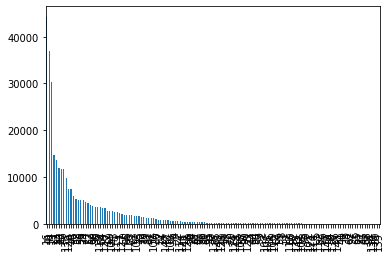

In [ ]:
# Count plot of all pokemon
df.num.value_counts().plot(kind = 'bar')

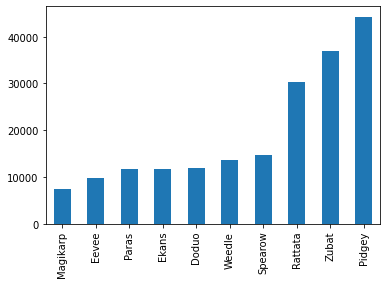

In [ ]:
# Count plot of the 10 most common pokemon
df.name.value_counts().sort_values()[-10:].plot(kind = 'bar')

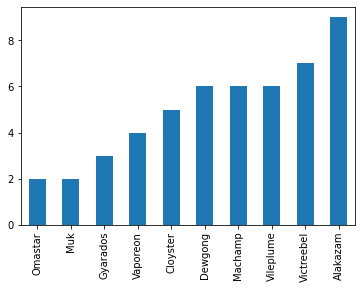

In [ ]:
# Challenge 2: Count plot of the 10 least common pokemon
df.name.value_counts().sort_values()[:10].plot(kind = 'bar')

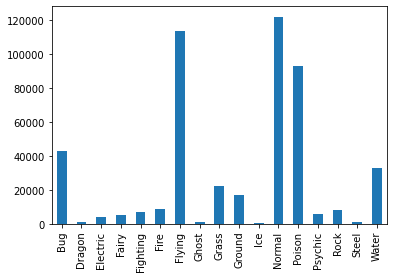

In [ ]:
# Count plot of different types
counts = df['type 1'].value_counts().add(df['type 2'].value_counts(), fill_value = 0)
counts.plot(kind='bar')

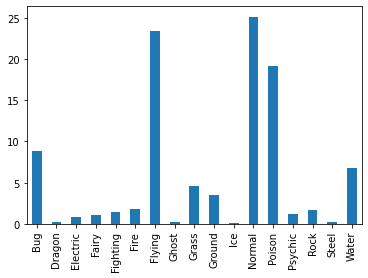

In [ ]:
# Normalized Probabilities Plot
(100*counts/counts.sum()).plot(kind='bar')

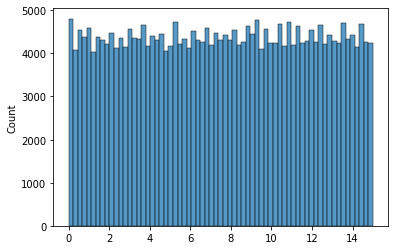

In [ ]:
# Spawn duration
spawn = df[df['encounter_ms'].notnull()]['encounter_ms'] - df[df['encounter_ms'].notnull()]['spawn_ms']
sns.histplot(spawn.astype('timedelta64[s]')/60)

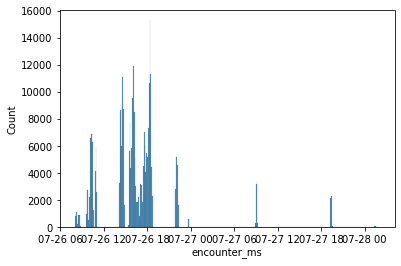

In [ ]:
sns.histplot(data=df,x='encounter_ms')

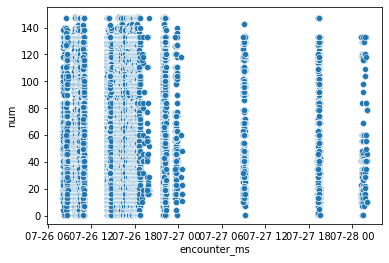

In [ ]:
# Scatterplot of encounter times of different pokemon
sns.scatterplot(data=df,x='encounter_ms',y='num')

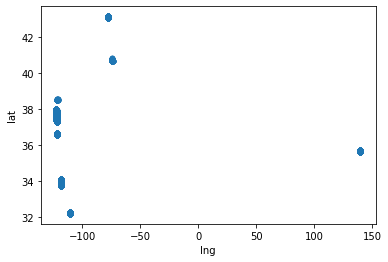

In [ ]:
# Geospatial analysis of plots
df.plot(kind='scatter', x='lng', y='lat')

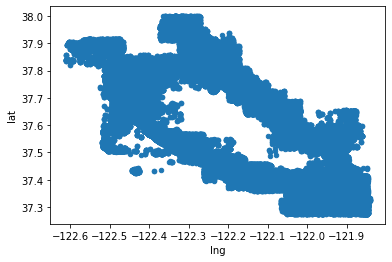

In [ ]:
# Selecting only points at San Francisco
sanfrancisco_df = df[(df['lng'] <= -121.674) & (df['lat'] >= 37.196)]
sanfrancisco_df.plot(kind = 'scatter', x = 'lng', y='lat')

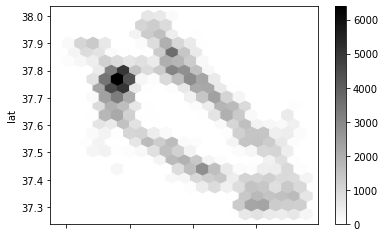

In [ ]:
sanfrancisco_df.plot(kind='hexbin', x='lng', y='lat', gridsize=20, colormap='binary')

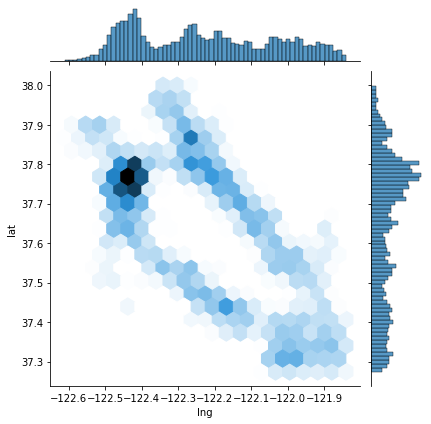

In [ ]:
# Using Seaborn to generate a hexbin jointplot
sns.jointplot(x=sanfrancisco_df['lng'],y=sanfrancisco_df['lat'], kind='hex', joint_kws={'gridsize':20})

## Plot.ly
One caveat for both Seaborn & Matplotlib is the lack of interactivity (ability to zoom in to graphs, pan graph windows, and display information about datapoints when hovering over them). Plotly provides a viable, yet relatively high performance alternative. 

In [ ]:
import plotly.express as px

In [ ]:
# Taking another look at our processed dataframe
df

,num,name,type 1,type 2,lat,lng,encounter_ms,spawn_ms
0,13,Weedle,Bug,Poison,37.793591,-122.408722,2016-07-26 08:03:07.732,2016-07-26 07:58:39.988
1,16,Pidgey,Normal,Flying,37.794746,-122.406418,2016-07-26 08:04:57.172,2016-07-26 07:58:39.992
2,41,Zubat,Poison,Flying,37.794998,-122.404381,2016-07-26 08:11:49.924,2016-07-26 07:58:39.991
3,16,Pidgey,Normal,Flying,37.795643,-122.407127,NaT,2016-07-26 07:58:40.134
4,60,Poliwag,Water,NaN,37.795593,-122.406334,2016-07-26 08:12:21.876,2016-07-26 07:58:40.153
...,...,...,...,...,...,...,...,...
314100,84,Doduo,Normal,Flying,37.778625,-122.475960,2016-07-28 01:54:59.836,2016-07-28 01:47:33.557
314101,56,Mankey,Fighting,NaN,37.769260,-122.483650,2016-07-28 01:58:34.084,2016-07-28 01:47:33.557
314102,29,Nidoran♀,Poison,NaN,37.768921,-122.483299,2016-07-28 01:49:32.436,2016-07-28 01:47:33.557
314103,10,Caterpie,Bug,NaN,37.773064,-122.483383,2016-07-28 02:00:57.676,2016-07-28 01:47:33.556


In [ ]:
# Plotting a count plot of pokemon types using plotly
fig = px.bar(x=counts.index, y=counts, labels={'y':'Counts','x':'Pokemon Types'}, color=counts.index, title='Histogram of Pokemon Types')
fig.show()

In [ ]:
# Plotly Histogram
fig = px.histogram(df,x='encounter_ms')
fig.show()

In [ ]:
# Interactive scatterplot with plotly
fig = px.scatter(df.sample(30000), x="encounter_ms", y="num")
fig.show()

In [ ]:
fig = px.scatter(sanfrancisco_df.sample(30000),x='lng',y='lat',hover_name='name',color='num',hover_data=['spawn_ms'])
fig.show()

## Kepler.gl

Plotting geospatial data using Matplotlib is viable using a traditional scatterplot or a hexbin plot, but there offers way more efficient and useful tools specifically engineered to handle such geospatial datasets. 

Kepler.gl is a powerful open source geospatial analysis tool for large-scale data sets, that offers both visual appeal and a broad range of functionality including interactivity, filters and different map types. 

For more information, visit their [GitHub](https://github.com/keplergl/kepler.gl)

Here, we will be importing our dataset into keplergl, and exploring the various functionality within this tool.

In [ ]:
! pip install keplergl

In [ ]:
from keplergl import KeplerGl
# to view Kepler GL output
from google.colab import output
output.enable_custom_widget_manager()

In [ ]:
# Drop unnecessary data to avoid bloating
spawn_map_df = df.drop(columns=['encounter_ms','type 1','type 2'])

In [ ]:
spawn_map_df.head()

,num,name,lat,lng,spawn_ms
0,13,Weedle,37.793591,-122.408722,2016-07-26 07:58:39.988
1,16,Pidgey,37.794746,-122.406418,2016-07-26 07:58:39.992
2,41,Zubat,37.794998,-122.404381,2016-07-26 07:58:39.991
3,16,Pidgey,37.795643,-122.407127,2016-07-26 07:58:40.134
4,60,Poliwag,37.795593,-122.406334,2016-07-26 07:58:40.153


In [ ]:
# Displaying a map of all spawns
spawn_map = KeplerGl(height=400)
spawn_map.add_data(data=spawn_map_df.sample(30000), name="Spawn Map Data")
spawn_map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(data={'Spawn Map Data': {'index': [286422, 111531, 194, 9158, 15914, 229298, 140053, 22676, 85998, 17…

In [ ]:
# Drop unnecessary data to avoid bloating
unencountered_map_df = df[df['encounter_ms'].isnull()].drop(columns={'encounter_ms'})
print(unencountered_map_df.shape)
unencountered_map_df

(20968, 7)


,num,name,type 1,type 2,lat,lng,spawn_ms
3,16,Pidgey,Normal,Flying,37.795643,-122.407127,2016-07-26 07:58:40.134
18,19,Rattata,Normal,NaN,37.301285,-121.998093,2016-07-26 08:04:37.295
27,133,Eevee,Normal,NaN,37.301853,-121.950996,2016-07-26 08:04:37.338
32,19,Rattata,Normal,NaN,37.303032,-121.999779,2016-07-26 08:04:37.364
44,46,Paras,Bug,Grass,37.303844,-121.975616,2016-07-26 08:04:37.481
...,...,...,...,...,...,...,...
313970,14,Kakuna,Bug,Poison,37.763771,-122.426773,2016-07-28 01:27:57.922
313983,14,Kakuna,Bug,Poison,37.763771,-122.426773,2016-07-28 01:27:59.224
314034,41,Zubat,Poison,Flying,37.744556,-122.476135,2016-07-28 01:42:23.874
314040,29,Nidoran♀,Poison,NaN,37.741760,-122.469498,2016-07-28 01:43:50.083


In [ ]:
# Challenge 3: Displaying a map of all unencountered pokemon
unencountered_map = KeplerGl(height=400)
unencountered_map.add_data(data=unencountered_map_df, name="Unencountered Map Data")
unencountered_map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(data={'Unencountered Map Data': {'index': [3, 18, 27, 32, 44, 72, 114, 133, 138, 150, 152, 182, 196, …

In [ ]:
# Using the kepler.gl webapp
unencountered_map_df.to_csv('unencountered_map.csv')
spawn_map_df.sample(30000).to_csv('spawn_map.csv')

## Insights gained:
1. Anomalous data found at **Tokyo** region
2. Top 10 most common pokemon: **Pidgey, Zubat, Rattata, Spearow, Weedle, Doduo, Ekans, Paras, Eevee, Magikarp**
3. Top 10 least common pokemon: **Omastar, Muk, Gyarados, Vaporeon, Cloyster, Machamp, Vileplume, Dewgong, Victreebel, Alakazam**
4. Most common spawn types: **Normal, Flying, Poison**
5. Spawn Duration: **15mins**
6. Dataset clustered on **26 July 2016**, encounters peak at **18:20**
7. **No underlying hotspots** for unencountered pokemon